In [117]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib as mpl

import numpy as np

%config InlineBackend.figure_format='retina'
%matplotlib inline

mpl.rcParams['figure.figsize'] = 8, 5

In [118]:
train = pd.read_csv("../data/train.csv")

### Columns in train dataset

In [119]:
for column in train.columns:
    print(column)

image_id
width
height
bbox
source


### Quick summary

In [120]:
nimages = !ls -l ../data/train | grep jpg | wc -l
nimages = int(nimages[0])

In [231]:
print(f"Number of records: {len(train.index):,}")
print(f"Total number of images: {nimages:,}")
print(f"Number of unique images with bounding boxes: {len(train.image_id.unique()):,}")
print(f"Images with no bounding boxes: {100-len(train.image_id.unique())/nimages*100:.2f}%")
print(f"Images with no bounding boxes: {-len(train.image_id.unique()) +nimages:,}")
print(f"Average bounding boxes per image: {len(train.index) / len(train.image_id.unique()):.1f}")

Number of records: 147,793
Total number of images: 3,422
Number of unique images with bounding boxes: 3,373
Images with no bounding boxes: 1.43%
Images with no bounding boxes: 49
Average bounding boxes per image: 43.8


### Distribution of bounding boxes

For images with at least one bounding box

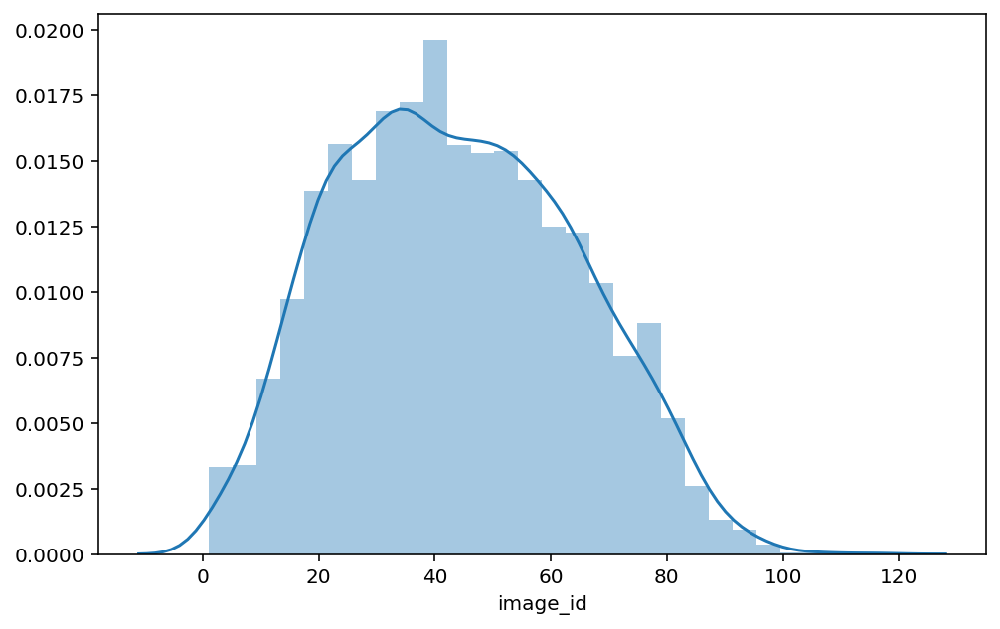

In [122]:
bb_counts = train.image_id.value_counts()
sns.distplot(bb_counts)

In [123]:
print(f"Images with 1 bounding box: {(bb_counts==1).sum():,}")
print(f"Images with <=5 bounding boxes: {(bb_counts<=5).sum():,}")
print(f"Max number of bounding boxes: {max(bb_counts):,}")

Images with 1 bounding box: 10
Images with <=5 bounding boxes: 46
Max number of bounding boxes: 116


### Counts by source

In [134]:
source_counts = (train
 .groupby("source", as_index=False)["image_id"]
 .count()
 .rename({"image_id": "bb_count"}, axis=1)
 .merge(
     train
     .filter(["image_id", "source"])
     .drop_duplicates()
     .groupby("source", as_index=False)["image_id"]
     .count()
     .rename({"image_id": "images"}, axis=1)
 )
 .assign(avg_bb=lambda x: x["bb_count"] / x["images"])
 .assign(perc_images=lambda x: x["images"] / len(train.image_id.unique())*100)
 .filter(["source", "images", "perc_images", "avg_bb"])
 .sort_values("images", ascending=False)
)
source_counts

,source,images,perc_images,avg_bb
0,arvalis_1,1055,31.277794,43.332701
3,ethz_1,747,22.146457,68.927711
2,arvalis_3,559,16.572784,29.812165
5,rres_1,432,12.807590,46.842593
1,arvalis_2,204,6.048028,20.485294
6,usask_1,200,5.929440,29.035000
4,inrae_1,176,5.217907,21.028409


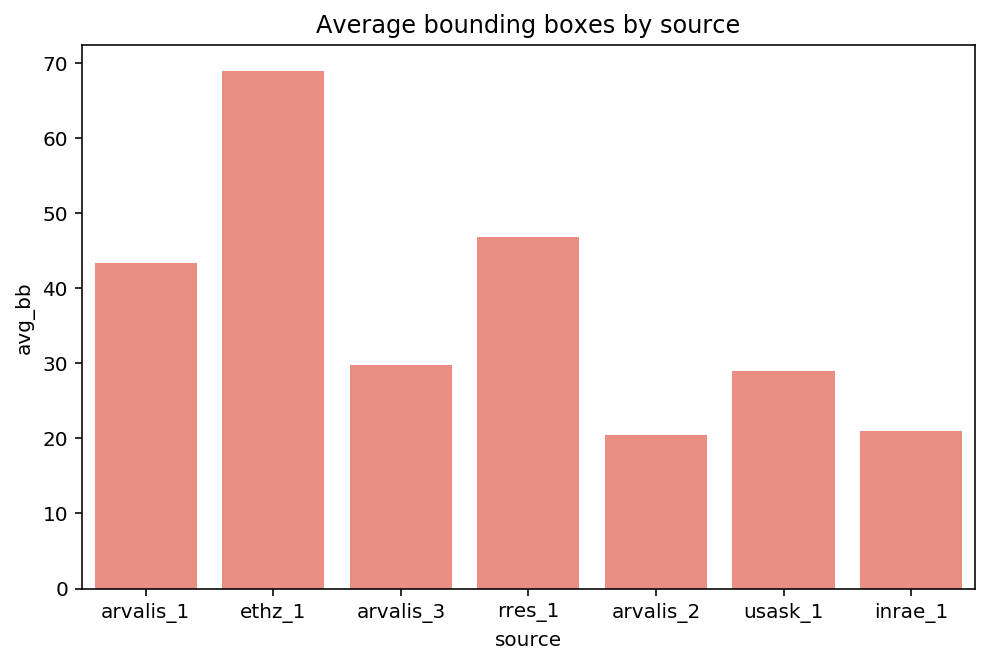

In [125]:
ax = source_counts.pipe((sns.barplot, "data"), x="source", y="avg_bb", color="salmon")
ax.set_title("Average bounding boxes by source");

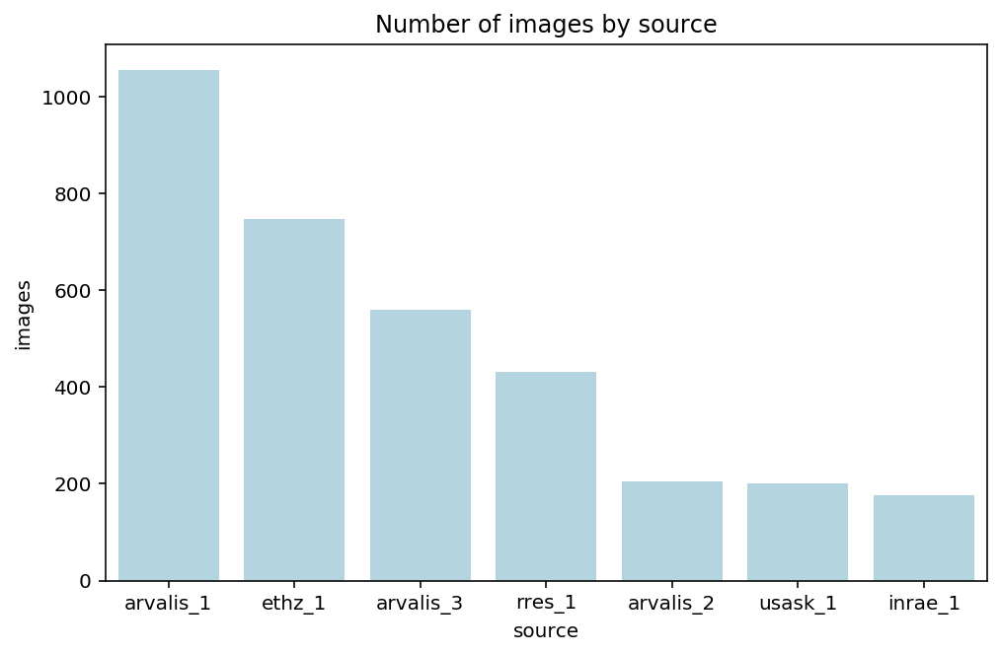

In [127]:
ax = source_counts.pipe((sns.barplot, "data"), x="source", y="images", color="lightblue")
ax.set_title("Number of images by source");

### Width and height
All images are of the same size $1024 \times 1024$

In [128]:
assert len(set(train.height)) == 1
assert len(set(train.width)) == 1

### Sample pictures

In [253]:
imageids = train.image_id.unique()

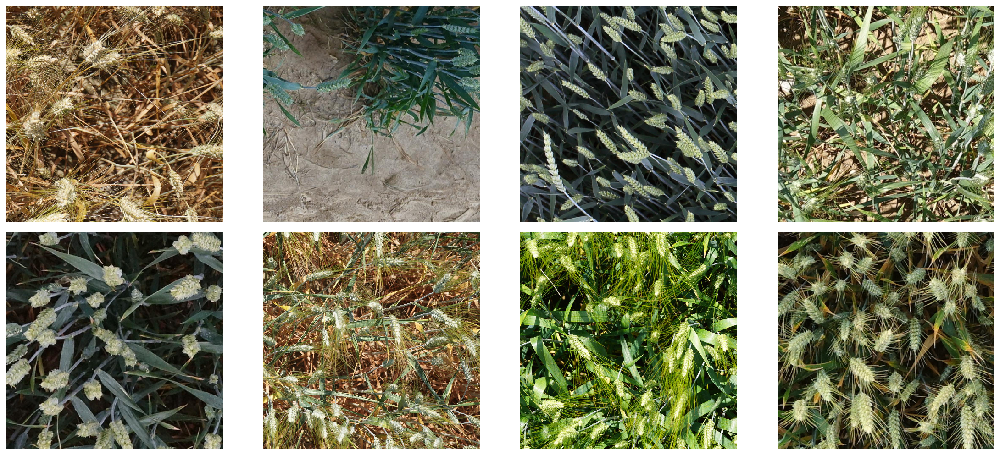

In [130]:
indices = np.random.choice(np.arange(len(imageids)), 8)
selected_images = imageids[indices]

f, axes = plt.subplots(2, 4, figsize=(16, 7))

for i, ax in enumerate(axes.flatten()):
    selected_image = selected_images[i]
    imagefile = f"../data/train/{selected_image}.jpg"
    ax.imshow(mpimg.imread(imagefile))
    ax.set_axis_off()
    
plt.tight_layout()

### Printing images with bounding box

In [280]:
def get_segments(image_id):
    bb = [eval(bb) for bb in train[train.image_id == image_id].bbox.values]
    boxes = []
    
    for b in bb:
        x0, y0, w, h = b

        segment = [
            ([x0, x0+w], [y0, y0]),
            ([x0+w, x0+w], [y0, y0+h]),
            ([x0+w, x0], [y0+h, y0+h]),
            ([x0, x0], [y0+h, y0])
        ]

        segx = [seg[0] for seg in segment]
        segy = [seg[1] for seg in segment]
        
        boxes += [(segx, segy)]
    
    return boxes

def plot_image(image_id, ax):
    boxes = get_segments(image_id)

    imagefile = f"../data/train/{image_id}.jpg"
    ax.imshow(mpimg.imread(imagefile))

    for box in boxes:
        segx, segy = box
        ax.plot(segx[0], segy[0], color="r")
        ax.plot(segx[1], segy[1], color="r")
        ax.plot(segx[2], segy[2], color="r")
        ax.plot(segx[3], segy[3], color="r")
        
    ax.set_xlim(0, 1024)
    ax.set_ylim(1024, 0)
    ax.set_axis_off()
    
    ax.set_title(image_id)

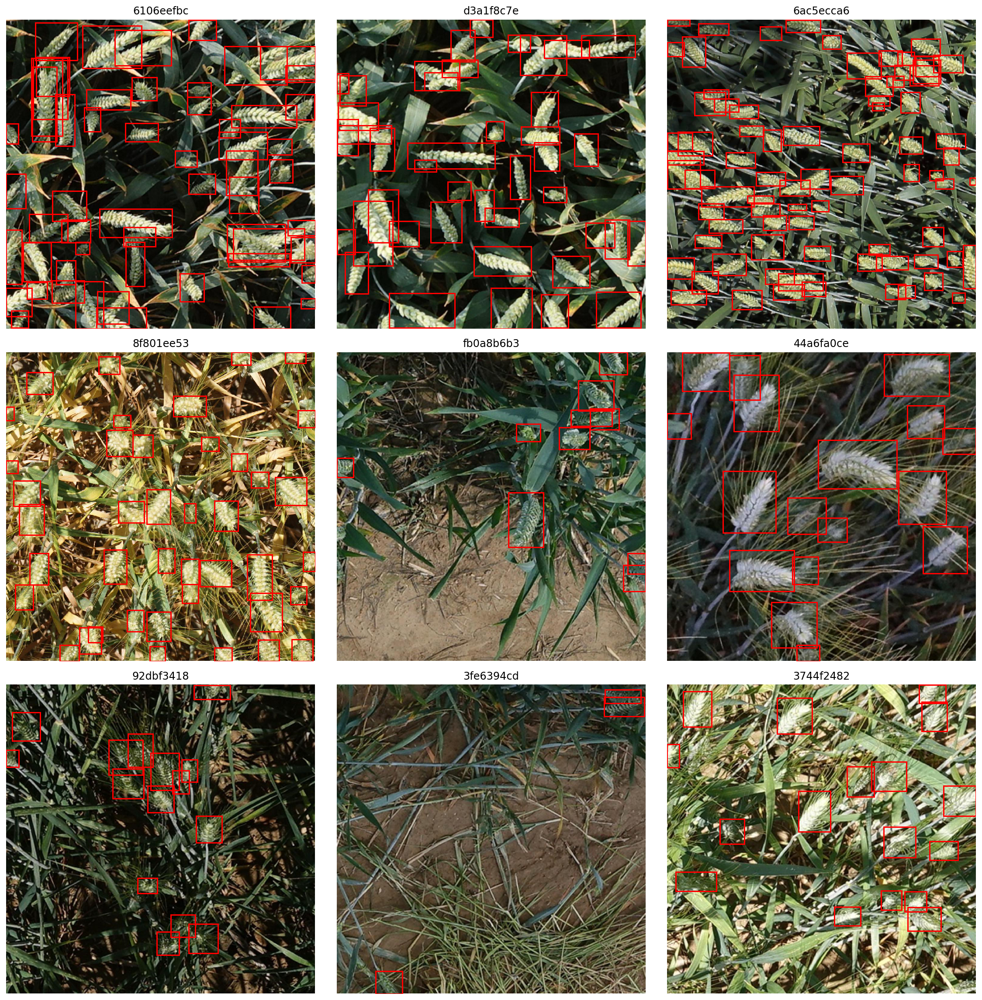

In [282]:
image_ids = np.random.choice(imageids, 9)
f, axes = plt.subplots(3, 3, figsize=(16, 16))

for i, ax in enumerate(axes.flatten()):
    plot_image(image_ids[i], ax)
    
plt.tight_layout()

### Plotting images without bounding boxes

In [268]:
filenames = !ls -l ../data/train | grep jpg
allimageids = [output.split()[8][:-4] for output in filenames]
no_bb_images = np.array(list(set(allimageids) - set(imageids)))

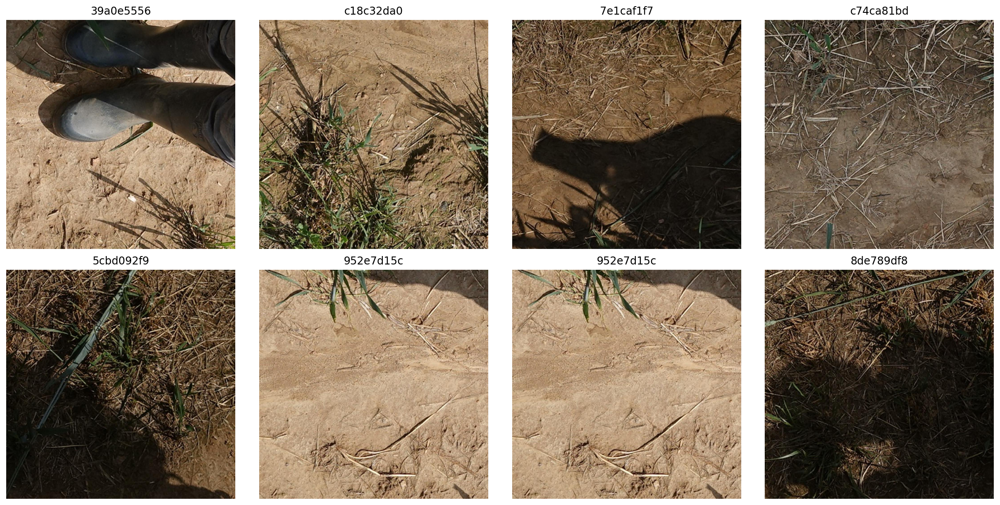

In [283]:
indices = np.random.choice(np.arange(len(no_bb_images)), 8)
selected_images = no_bb_images[indices]

f, axes = plt.subplots(2, 4, figsize=(16, 8))

for i, ax in enumerate(axes.flatten()):
    selected_image = selected_images[i]
    imagefile = f"../data/train/{selected_image}.jpg"
    ax.imshow(mpimg.imread(imagefile))
    ax.set_axis_off()
    ax.set_title(selected_image)
    
plt.tight_layout()